# Машинное обучение за час #

*Внимание! Этот ноутбук не способен заменить полноценный курс по ML или даже одну его лекцию. Цель данного ноутбука — показать, что это круто, интересно и даже может работать.*

<img src="files/ml.jpg">

Если вы хотите и изучить теоретические и практические основы ML, авторы рекомендуют:
1. [Курс машинному обучению от Воронцова](http://www.machinelearning.ru/wiki/index.php?title=%D0%9C%D0%B0%D1%88%D0%B8%D0%BD%D0%BD%D0%BE%D0%B5_%D0%BE%D0%B1%D1%83%D1%87%D0%B5%D0%BD%D0%B8%D0%B5_%28%D0%BA%D1%83%D1%80%D1%81_%D0%BB%D0%B5%D0%BA%D1%86%D0%B8%D0%B9%2C_%D0%9A.%D0%92.%D0%92%D0%BE%D1%80%D0%BE%D0%BD%D1%86%D0%BE%D0%B2%29)
2. Любой другой курс на Coursera
3. Очень, очень много практики

## 1. Постановка задачи ##

На [IMDb](https://www.imdb.com/) к каждому фильму расставлены теги (например, Comedy, Romance, Animation, Adventure). Давайте попробуем решить следующую задачу: по кадру из фильма определить, является ли этот фильм анимацией, или нет.  
Подобная задача называется **задачей классификации** (это когда нам нужно отнести каждый объект к определённому классу, ещё есть **задача регрессии** — например, предсказывание температуры воздуха, и **задача ранжирования** — например, определение более релевантных документов в поисковой выдаче)

<img src="files/hesher.jpg">
<h4><i><center>Это не анимация</center></i></h4>

<img src="files/secret_kells.jpg">
<h4><i><center>Это анимация</center></i></h4>

Как бы задача не была приближена к реальности, всегда стоит ввести более-менее формальную постановку задачи: мы должны ввести метрику качества, на основе которой будем принимать решение, а также понять входные и выходные параметры метода.

**Вопрос.** Что у на входе алгоритма? Что на выходе? Какая метрика качества?

*Что я думаю по этому поводу*

## 2. Загрузка данных ##

Как правило, в таких задачах есть открытая выборка, ответы для которой доступны всем, и закрытая, на которой производится итоговое тестирование алгоритма. В нашем случае открытая выборка описывается в файле *train_dataset.json*, а закрытая в *test_dataset.json*  

In [9]:
import json

def load_json_from_file(filename):
    with open(filename, "r") as f:
        return json.load(f, strict=False)

In [10]:
train_data = load_json_from_file('train_dataset.json')
train_data[0]

{'idx': 0,
 'image': 'train_data/images/0.jpg',
 'title': 'バトル・ロワイアル',
 'is_animation': False,
 'score': 7.3}

In [11]:
test_data = load_json_from_file('test_dataset.json')
test_data[0]

{'idx': 0,
 'image': 'test_data/images/0.jpg',
 'title': 'The Human Centipede (First Sequence)',
 'is_animation': False,
 'score': 4.9}

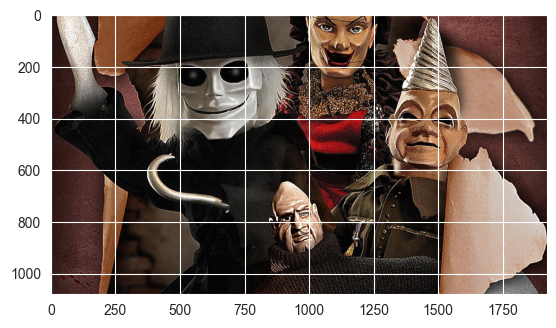

In [4]:
import matplotlib.pyplot as plt
from PIL import Image
plt.imshow(Image.open('train_data/images/32.jpg'))

Информация о каждом фильме хранится в виде списка из словарей. Чтобы удобнее работать с такими данными, лучше представить их в виде именованных таблиц. Для этого нам поможет библиотека pandas:

In [20]:
import pandas as pd

In [12]:
train_df = pd.DataFrame(train_data)
test_df = pd.DataFrame(test_data)
train_df.head()

,idx,image,title,is_animation,score
0,0,train_data/images/0.jpg,バトル・ロワイアル,False,7.3
1,1,train_data/images/1.jpg,Return of the Seven,False,5.3
2,2,train_data/images/2.jpg,Madagascar,True,6.6
3,3,train_data/images/3.jpg,無間道III: 終極無間,False,7.0
4,4,train_data/images/4.jpg,The Net,False,5.6


In [13]:
test_df.iloc[32:34]

,idx,image,title,is_animation,score
32,32,test_data/images/32.jpg,Star Trek V: The Final Frontier,False,5.6
33,33,test_data/images/33.jpg,Особенности национальной рыбалки,False,6.8


Зачем это нужно? Например, мы можем в одну строку посмотреть только те фильмы, которые являются анимационными:

In [15]:
train_df[train_df.is_animation == False]

,idx,image,title,is_animation,score
0,0,train_data/images/0.jpg,バトル・ロワイアル,False,7.3
1,1,train_data/images/1.jpg,Return of the Seven,False,5.3
3,3,train_data/images/3.jpg,無間道III: 終極無間,False,7.0
4,4,train_data/images/4.jpg,The Net,False,5.6
5,5,train_data/images/5.jpg,Che: Part Two,False,6.7
...,...,...,...,...,...
2734,2734,train_data/images/2734.jpg,Alex Cross,False,5.1
2736,2736,train_data/images/2736.jpg,Les Ripoux,False,6.5
2737,2737,train_data/images/2737.jpg,"Быстрее, чем кролики",False,6.3
2739,2739,train_data/images/2739.jpg,Sherlock Holmes Faces Death,False,7.2


In [17]:
train_df.sort_values(by='score', ascending=False).tail(11)

,idx,image,title,is_animation,score
1578,1578,train_data/images/1578.jpg,Charlie Chan's Courage,False,0.0
2481,2481,train_data/images/2481.jpg,Big Man: Polizza inferno,False,0.0
1580,1580,train_data/images/1580.jpg,Hold That Line,False,0.0
980,980,train_data/images/980.jpg,Otoko wa tsurai yo: Torajiro aiaigasa,False,0.0
2195,2195,train_data/images/2195.jpg,Crazy Over Horses,False,0.0
2173,2173,train_data/images/2173.jpg,Charlie Chan's Greatest Case,False,0.0
334,334,train_data/images/334.jpg,Otoko wa tsurai yo: Torajiro koiuta,False,0.0
2574,2574,train_data/images/2574.jpg,Mörderische Erpressung,False,0.0
11,11,train_data/images/11.jpg,Colt Comrades,False,0.0
1609,1609,train_data/images/1609.jpg,Paris Playboys,False,0.0


Или посмотреть на самые высокооценённые фильмы:

In [19]:
train_df.sort_values(by='score', ascending=Fals).head(20)

,idx,image,title,is_animation,score
2412,2412,train_data/images/2412.jpg,Bowery Battalion,False,10.0
2615,2615,train_data/images/2615.jpg,僕等がいた 前篇,False,9.0
2503,2503,train_data/images/2503.jpg,Bloodfight,False,9.0
2193,2193,train_data/images/2193.jpg,Dreileben: Etwas Besseres als den Tod,False,9.0
1754,1754,train_data/images/1754.jpg,傷物語 第二部〈Ⅱ熱血篇〉,True,8.9
319,319,train_data/images/319.jpg,人間の條件 第３部望郷篇／第４部戦雲篇,False,8.5
1784,1784,train_data/images/1784.jpg,Furia à Bahia pour OSS 117,False,8.5
566,566,train_data/images/566.jpg,Üvegtigris,False,8.5
1600,1600,train_data/images/1600.jpg,人間の條件 第１部純愛篇／第２部激怒篇,False,8.5
1074,1074,train_data/images/1074.jpg,Снежная королева 3. Огонь и лед,True,8.5


In [ ]:
train_df[train_df.is_animation == False]

**Теперь мы можем ответить на вопрос, какую метрику использовать**

Давайте также посмотрим на примеры картинок, с которыми мы будем работать

In [14]:
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline
sns.set_context('poster')
plt.rcParams['font.family'] = 'Arial'

import cv2

In [15]:
import numpy as np
def visualize_examples(images, cols=3, titles=None):
    assert len(images) == len(titles)
    n_images = len(images)
    fig = plt.figure()
    for n, (image, title) in enumerate(zip(images, titles)):
        a = fig.add_subplot(cols, int(np.ceil(n_images/float(cols))), n + 1)
        if image.ndim == 2:
            plt.gray()
        plt.imshow(image)
        plt.axis('off')
        a.set_title(title, font='DejaVu Sans')
    fig.set_size_inches(np.array(fig.get_size_inches()) * n_images)
    plt.show()

In [22]:
# Проверка для использования названий только с печатаемыми буквами
def is_latin_or_cyrillic(text):
    allowed_chars = '0123456789' \
                  + 'abcdefghijklmnopqrstuvwxyzABCDEFGHIJKLMNOPQRSTUVWXYZ' \
                  + 'АаБбВвГгДдЕеЁёЖжЗзИиЙйКкЛлМмНнОоПпРрСсТтУуФфХхЦцЧчШшЩщЪъЫыЬьЭэЮюЯя' \
                  + '!"#$%&\'()*+,-./:;<=>?@[\\]^_`{|}~ \t\n\r\x0b\x0c'
    return len(set(text) - set(allowed_chars)) == 0

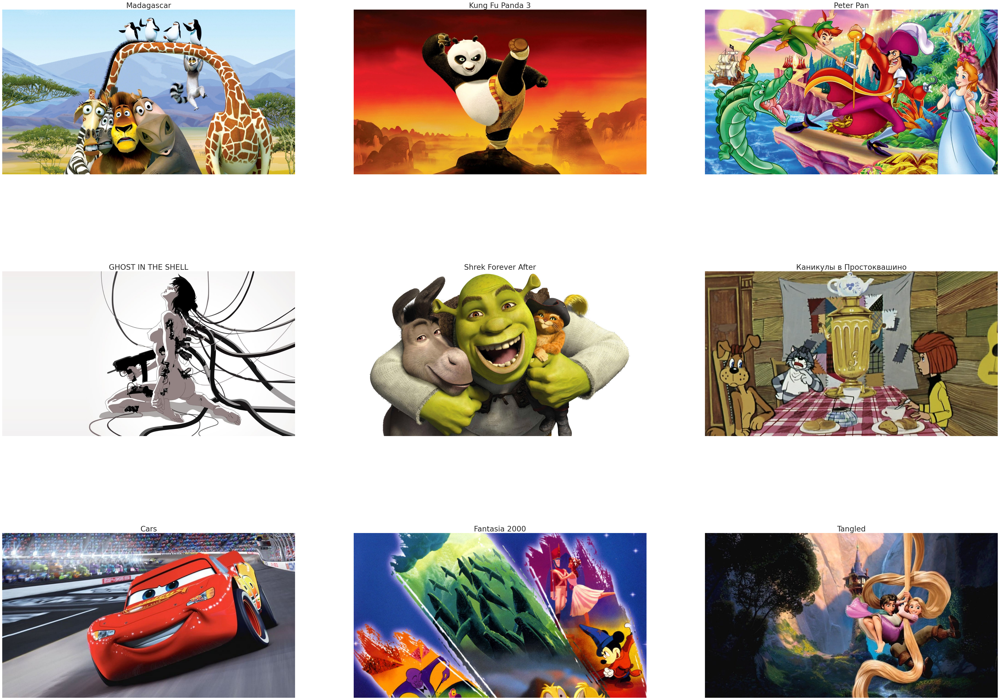

In [23]:
train_animation_sample = train_df[(train_df.is_animation == True) & (train_df.title.apply(is_latin_or_cyrillic))].head(9)
animation_examples = [cv2.imread(path)[:, :, ::-1] for path in train_animation_sample['image']]
visualize_examples(animation_examples, titles=train_animation_sample['title'])

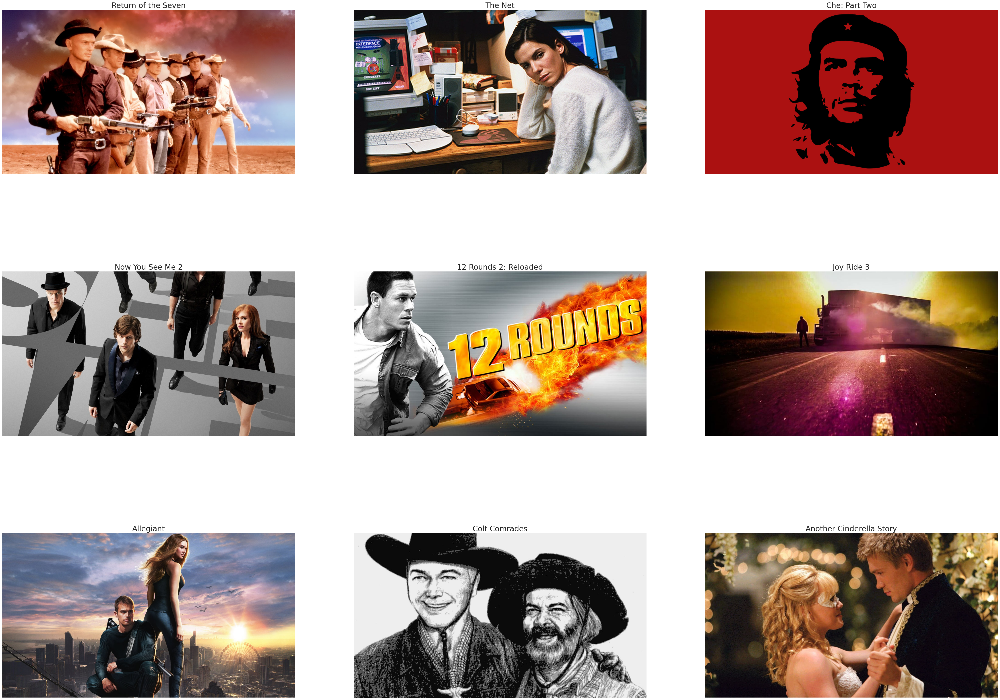

In [24]:
train_not_animation_sample = train_df[(train_df.is_animation == False) & (train_df.title.apply(is_latin_or_cyrillic))].head(9)
regular_examples = [cv2.imread(path)[:, :, ::-1] for path in train_not_animation_sample['image']]
visualize_examples(regular_examples, titles=train_not_animation_sample['title'])

## 3. Придумываем признаки ##

Как и в случае с детектором смен сцен, нам нужно придумать признаки, которые бы неплохо описывали природу исходного изображения 

**Вопрос.** Какие признаки будем использовать?

In [13]:
from tqdm.notebook import tqdm

In [4]:
def features_function(image):
    return {
        **{'brightness': image.mean()},
        **dict(
            [(f'color_component_{color}', image[:,:,i].mean()) for i, color in enumerate('BGR')]
        )
    }

In [6]:
def generate_table(data):
    table = []
    for node in tqdm(data):
        current_features = {}
        image = cv2.imread(node['image'])
        
        current_features.update(features_function(image))
        
        current_features['is_animation'] = node['is_animation']
        table.append(current_features)
    return table

In [11]:
train_features = pd.DataFrame(generate_table(train_data))
test_features = pd.DataFrame(generate_table(test_data))

  0%|          | 0/2743 [00:00<?, ?it/s]

KeyboardInterrupt: 

In [16]:
train_features = generate_table(train_data)

  0%|          | 0/2743 [00:00<?, ?it/s]

In [23]:
train_features# = pd.DataFrame(train_features)

,brightness,color_component_B,color_component_G,color_component_R,is_animation
0,9.606800,0.926978,0.646220,27.247202,False
1,121.392688,93.802818,107.827712,162.547535,False
2,162.801713,160.545084,167.385713,160.474343,True
3,98.508371,110.176175,112.809423,72.539514,False
4,105.015088,98.233381,103.505799,113.306085,False
...,...,...,...,...,...
2738,129.360370,125.985018,148.561286,113.534805,True
2739,87.505446,87.505446,87.505446,87.505446,False
2740,110.039626,94.407762,105.605188,130.105929,False
2741,75.902949,82.766239,79.375841,65.566766,True


In [22]:
train_features

,brightness,color_component_B,color_component_G,color_component_R,is_animation
0,9.606800,0.926978,0.646220,27.247202,False
1,121.392688,93.802818,107.827712,162.547535,False
2,162.801713,160.545084,167.385713,160.474343,True
3,98.508371,110.176175,112.809423,72.539514,False
4,105.015088,98.233381,103.505799,113.306085,False
...,...,...,...,...,...
2738,129.360370,125.985018,148.561286,113.534805,True
2739,87.505446,87.505446,87.505446,87.505446,False
2740,110.039626,94.407762,105.605188,130.105929,False
2741,75.902949,82.766239,79.375841,65.566766,True


In [12]:
from joblib import Parallel, delayed
from tqdm import tqdm

In [13]:
def features_function(image):
    return {
        **{'brightness': image.mean(), 'variance': image.var()},
        **dict(
            [(f'color_component_{color}', image[:,:,i].mean()) for i, color in enumerate('BGR')]
        )
    }

def generate_features(node):
    current_features = {}
    image = cv2.imread(node['image'])

    current_features.update(features_function(image))

    current_features['is_animation'] = node['is_animation']
    return current_features
train_features = Parallel(n_jobs=6)(delayed(generate_features)(sample) for sample in train_data)
test_features = Parallel(n_jobs=6)(delayed(generate_features)(sample) for sample in test_data)
train_features = pd.DataFrame(train_features)
test_features = pd.DataFrame(test_features)

In [14]:
train_features

,brightness,variance,color_component_B,color_component_G,color_component_R,is_animation
0,9.606800,1673.257078,0.926978,0.646220,27.247202,False
1,121.392688,5318.554835,93.802818,107.827712,162.547535,False
2,162.801713,4994.969940,160.545084,167.385713,160.474343,True
3,98.508371,4136.945926,110.176175,112.809423,72.539514,False
4,105.015088,6902.073063,98.233381,103.505799,113.306085,False
...,...,...,...,...,...,...
2738,129.360370,3966.805890,125.985018,148.561286,113.534805,True
2739,87.505446,7081.575949,87.505446,87.505446,87.505446,False
2740,110.039626,8688.565996,94.407762,105.605188,130.105929,False
2741,75.902949,4136.029666,82.766239,79.375841,65.566766,True


## 4. Science staff ##

<img src="files/science.jpg">

Если бы мы решали задачу обычным способом, то нам пришлось бы писать какие-то условия, выставлять пороги и т.д поверх наших признаков. По сути, машинное обучение будет решать эту задачу за нас.  
Существует очень много методов машинного обучения, каждый из них в определённых условиях может работать лучше. Чтобы понимать заранее, когда какой метод лучше использовать, нужно понимать их теорию, но мы всегда сможем перебрать все способы :3

In [ ]:
import matplotlib as plt

plt.boxplot()

<AxesSubplot:xlabel='is_animation', ylabel='color_component_B'>

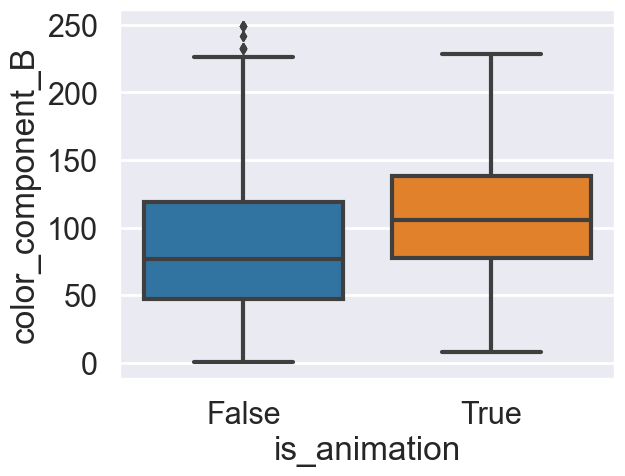

In [119]:
import seaborn as sns

sns.boxplot(
    data = train_features,
    x = 'is_animation',
    y = 'color_component_B',    
)

In [61]:
from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeClassifier

In [108]:
train_X = train_features.drop('is_animation', axis=1)
train_y = train_features['is_animation']

In [109]:
test_X = test_features.drop('is_animation', axis=1)
test_y = test_features['is_animation']

In [110]:
clf = DecisionTreeClassifier(class_weight='balanced')

In [1]:
type[train_X]

NameError: name 'train_X' is not defined

In [111]:
clf.fit(train_X, train_y)

DecisionTreeClassifier(class_weight='balanced')

In [112]:
train_Y = clf.predict(train_X)
test_Y = clf.predict(test_X)

In [113]:
from sklearn.metrics import accuracy_score, f1_score

In [114]:
print('Метрика на тренировочной выборке', accuracy_score(train_y, train_Y))
print('Метрика на контрольной выборке', accuracy_score(test_y, test_Y))

Метрика на тренировочной выборке 0.994896099161502
Метрика на контрольной выборке 0.985


In [115]:
print('Метрика на тренировочной выборке', f1_score(train_y, train_Y))
print('Метрика на контрольной выборке', f1_score(test_y, test_Y))

Метрика на тренировочной выборке 0.9843400447427293
Метрика на контрольной выборке 0.953125


**Вопрос.** Почему на тренировочной выборке метрика лучше, чем на контрольной? Верно ли, что если на тренировочной выборке у одного алгоритма качество лучше, чем у второго, то будет ли метрика лучше на контрольной?

## 5. Эксперименты и что может пойти не так ##

Во-первых, нам немного повезло — у нас есть контрольная выборка, на которой мы всегда можем проверить качество на ней. Вообще стоит сказать, что в первую очередь стоит обращать внимание на качество именно на контрольной выборке (на которой мы не обучались), так как она именно показывает способность обобщать знания, полученные на тренировочной выборке.

В задача детектора смены сцен контрльной выборке нет — её нужно создать самому, отделив какую-то часть из тренировочной.

In [ ]:
from sklearn.model_selection import train_test_split
# Разделить выборку на тренировочную и валидационную. В валидационной выборке окажется 20% всех примеров
new_train, new_val = train_test_split(train_data, test_size=0.2) 

Другой вариант — использовать кросс-валидацию, когда алгоритм обучается несколько раз, для каждого алгоритма исключается из тренировочной выборки небольшая часть примеров, на которых затем замеряются метрики.

<img src="files/cv.png">

Что ещё может пойти не так при замере метрик? В тренировочной и контрольной выборки должны быть более-менее независимые примеры. Например, в задании выше вполне могло оказаться, чтобы кадр из "Истории игрушек" был в обучении, а кадр из "Истории игрушек 2" оказался в контрольной выборке. Так делать нельзя, и такие ошибки приводят к большим расстройствам при оглашении результатов задания. 

Во-вторых, нам немного повезло, что мы достаточно быстро получили хорошее решение, и мы не пытаемся никак его улучшить. Улучшить алгоритм можно несколькими способами — например, добавить новые признаки, или опробовать новый классификатор. Важно использовать принцип "одно изменение = один эксперимент", т.е нельзя сравнивать алгоритм с предыдущей версией после 10 изменений — можно пропустить и хорошее изменение вместе с несколькими плохими, и наоборот, добавить несколько плохих изменений вместе с хорошими

В-третьих, данных может быть мало. Чтобы увеличить выборку, можно попробовать поворачивать/увеличивать/обрезать/менять яркость или контрастность. Это называется аугментацией

## 6. Немного контрольных вопросов ##

Попробуйте ответить на следующие вопросы:
* Пусть мы пытаемся определить фотографии кошек от фотографий собак. В тренировочной выборке около 500 кошек и 500 собак. Какие метрики качества можно использовать?
* Какие признаки стоит ещё попробовать для решения текущей задачи?
* Представим, что в текущей задаче было бы не по одному кадру из фильма, а по 10-20 штук. Как в таком случае разделить выборку на тренировочную и контрольную самым правильным способом?